In [119]:
import cv2
import glob
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams['figure.figsize'] = 15, 8

In [144]:
def pyr_down(image, n=1):
    if n <= 1:
        return image
    shrinked = image.copy()
    for time in xrange(n):
        shrinked = cv2.pyrDown(shrinked)
    return shrinked

def shrink(image, to_size=500):
    n = int(np.log2(max(image.shape) / to_size))
    return pyr_down(image, n=n)

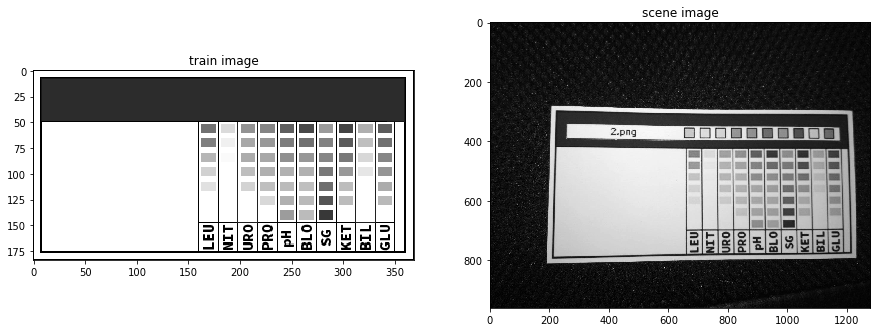

In [156]:
query_image = cv2.imread("/data/Y.Disk/work/urinalysis/images/stripe experiments/compact/template_mirror_no_stroke_border.png", cv2.IMREAD_GRAYSCALE)
scene_image = shrink(cv2.imread("/data/Y.Disk/work/urinalysis/images/stripe experiments/tests/good_printer/Xiaomi-daylight-2-flash/photo_2017-09-20_12-57-26#2.jpg", cv2.IMREAD_GRAYSCALE))

plt.subplot(1, 2, 1)
plt.title("train image")
plt.imshow(query_image, cmap='gray')
plt.subplot(1, 2, 2)
plt.title("scene image")
plt.imshow(scene_image, cmap='gray')

In [157]:
descr = cv2.AKAZE_create()
keypoints_query, descriptors_query = descr.detectAndCompute(query_image, mask=None)
keypoints_scene, descriptors_scene = descr.detectAndCompute(scene_image, mask=None)

MIN_MATCH_COUNT = 10

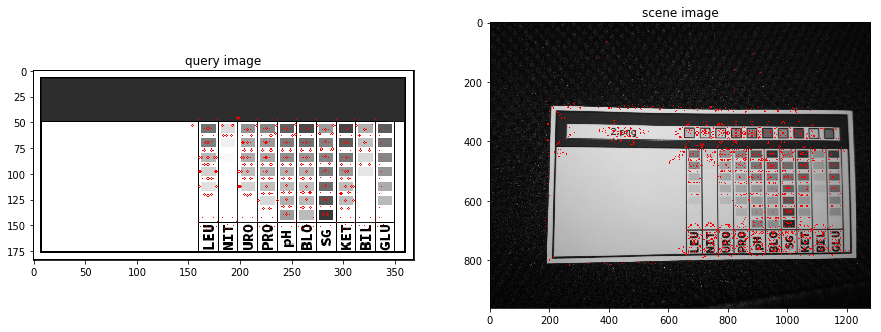

In [158]:
query_image_copy = cv2.cvtColor(query_image, cv2.COLOR_GRAY2RGB)
scene_image_copy = cv2.cvtColor(scene_image, cv2.COLOR_GRAY2RGB)

for kp in keypoints_scene:
    cv2.circle(scene_image_copy, (int(kp.pt[0]), int(kp.pt[1])), int(kp.size) / 5, (255, 0, 0))
for kp in keypoints_query:
    cv2.circle(query_image_copy, (int(kp.pt[0]), int(kp.pt[1])), int(kp.size) / 5, (255, 0, 0))

plt.subplot(1, 2, 1)
plt.title("query image")
plt.imshow(query_image_copy)
plt.subplot(1, 2, 2)
plt.title("scene image")
plt.imshow(scene_image_copy)

In [159]:
matcher = cv2.DescriptorMatcher_create(cv2.DESCRIPTOR_MATCHER_BRUTEFORCE)
matches = matcher.knnMatch(descriptors_query, descriptors_scene, k=2)

# store all the good matches as per Lowe's ratio test.
good = []
for m, n in matches:
    if m.distance < 0.7 * n.distance:
        good.append(m)

In [160]:
if len(good) >= MIN_MATCH_COUNT:
    src_pts = np.float32([keypoints_query[m.queryIdx].pt for m in good]).reshape(-1, 1, 2)
    dst_pts = np.float32([keypoints_scene[m.trainIdx].pt for m in good]).reshape(-1, 1, 2)

    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    matchesMask = mask.ravel().tolist()

    h, w = train_image.shape
    pts = np.float32([[0, 0], [0, h - 1], [w - 1, h - 1], [w - 1, 0]]).reshape(-1, 1, 2)
    dst = cv2.perspectiveTransform(pts, M)

    scene_image = cv2.polylines(scene_image, [np.int32(dst)], True, 255, 3, cv2.LINE_AA)
else:
    print "Not enough matches are found - %d/%d" % (len(good), MIN_MATCH_COUNT)
    matchesMask = None

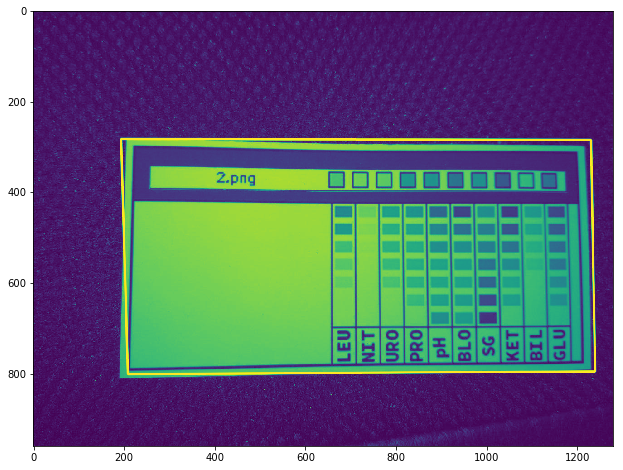

In [161]:
plt.imshow(scene_image)

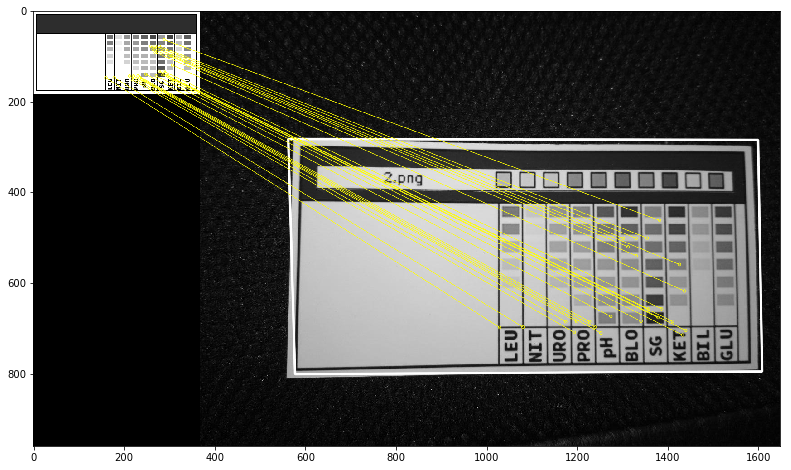

In [162]:
draw_params = dict(matchColor = (255, 255, 0), # draw matches in color
                   singlePointColor = None,
                   matchesMask = matchesMask, # draw only inliers
                   flags = 2)

match_image = cv2.drawMatches(query_image, keypoints_query, scene_image, keypoints_scene, good, None, **draw_params)

plt.imshow(match_image)
plt.show()

In [165]:
def match_image(scene_image, query_image):
    descr = cv2.AKAZE_create()
    keypoints_query, descriptors_query = descr.detectAndCompute(query_image, mask=None)
    keypoints_scene, descriptors_scene = descr.detectAndCompute(scene_image, mask=None)
    MIN_MATCH_COUNT = 10
    
    matcher = cv2.DescriptorMatcher_create(cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING)
    matches = matcher.knnMatch(descriptors_query, descriptors_scene, k=2)

    # store all the good matches as per Lowe's ratio test.
    good = []
    for m, n in matches:
        if m.distance < 0.7 * n.distance:
            good.append(m)           
    
    matches = matcher.knnMatch(descriptors_query, descriptors_scene, k=2)
    
    # store all the good matches as per Lowe's ratio test.
    good = []
    for m, n in matches:
        if m.distance < 0.7 * n.distance:
            good.append(m)
        
    if len(good) > MIN_MATCH_COUNT:
        src_pts = np.float32([keypoints_query[m.queryIdx].pt for m in good]).reshape(-1, 1, 2)
        dst_pts = np.float32([keypoints_scene[m.trainIdx].pt for m in good]).reshape(-1, 1, 2)

        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
        matchesMask = mask.ravel().tolist()

        h, w = query_image.shape
        pts = np.float32([[0, 0], [0, h - 1], [w - 1, h - 1], [w - 1, 0]]).reshape(-1, 1, 2)
        dst = cv2.perspectiveTransform(pts, M)

        scene_image = cv2.polylines(scene_image, [np.int32(dst)], True, 255, 3, cv2.LINE_AA)
    else:
        print "Not enough matches are found - %d/%d" % (len(good), MIN_MATCH_COUNT)
        matchesMask = None
        
    draw_params = dict(matchColor = (255, 255, 0), # draw matches in green color
                   singlePointColor = None,
                   matchesMask = matchesMask, # draw only inliers
                   flags = 2)

    match_image = cv2.drawMatches(query_image, keypoints_query, scene_image, keypoints_scene, good, None, **draw_params)

    plt.imshow(match_image)
    plt.show()

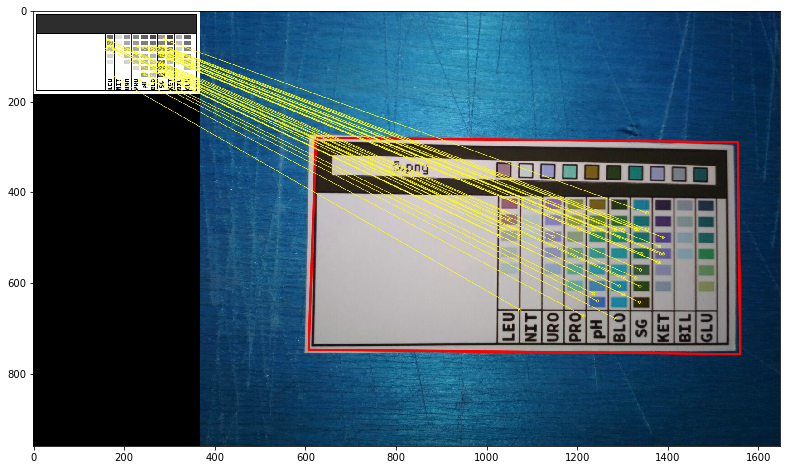

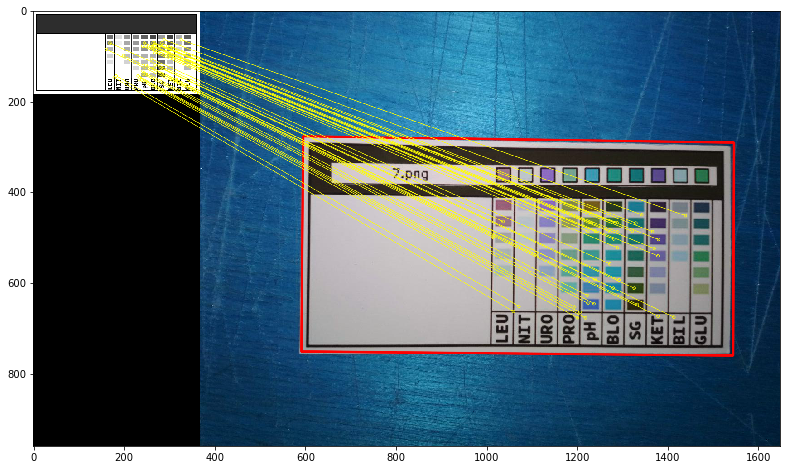

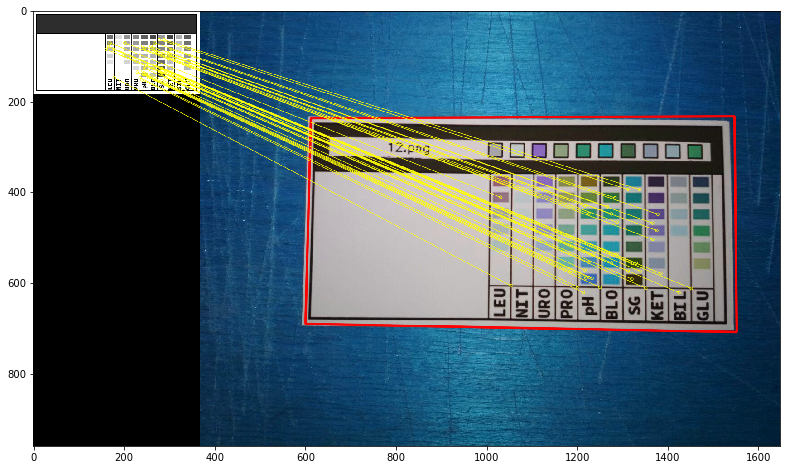

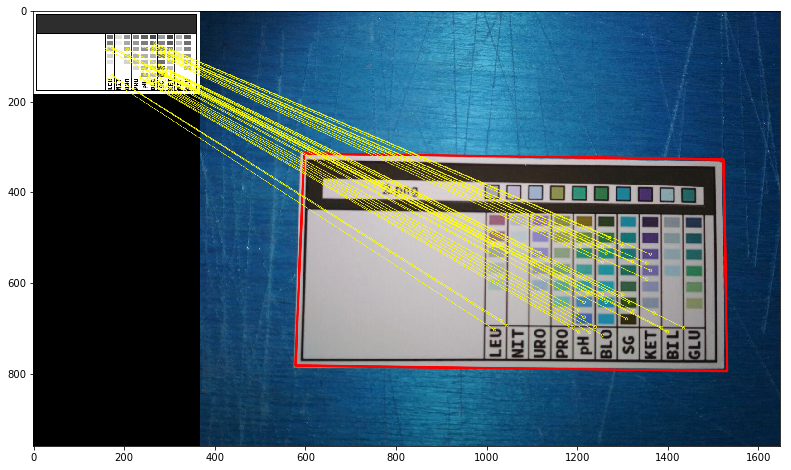

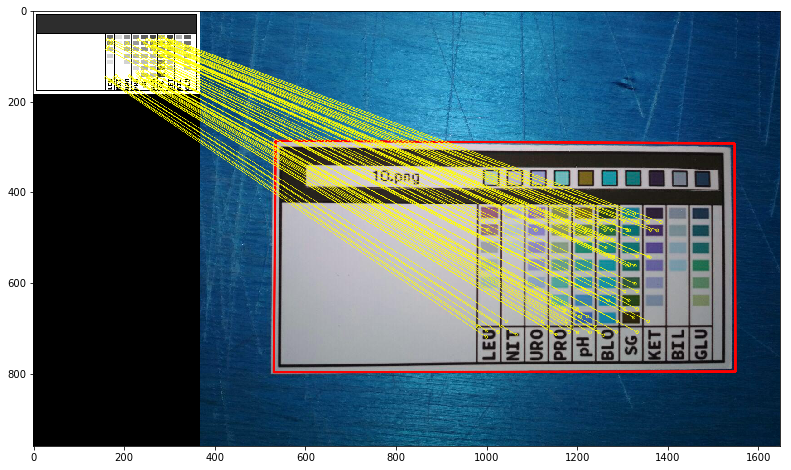

...

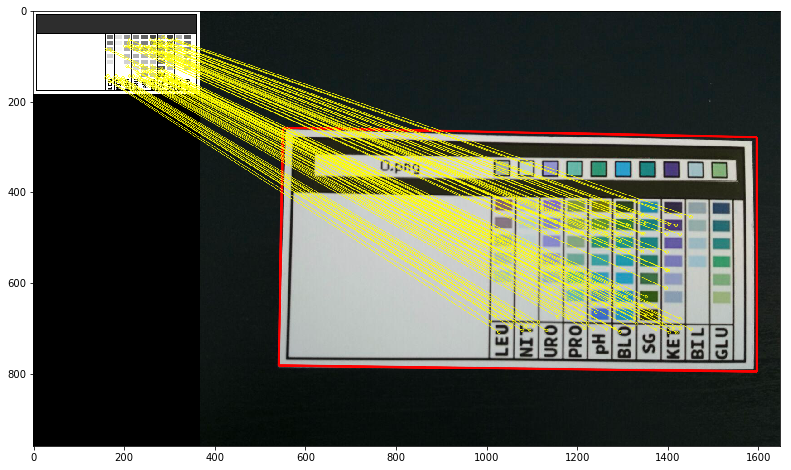

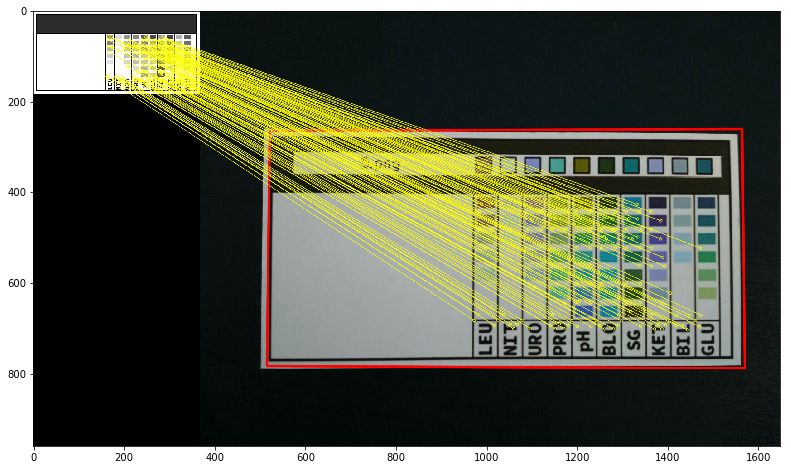

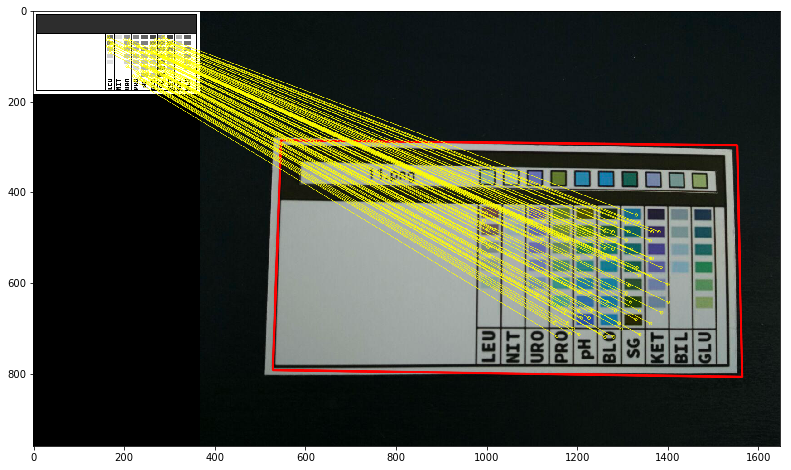

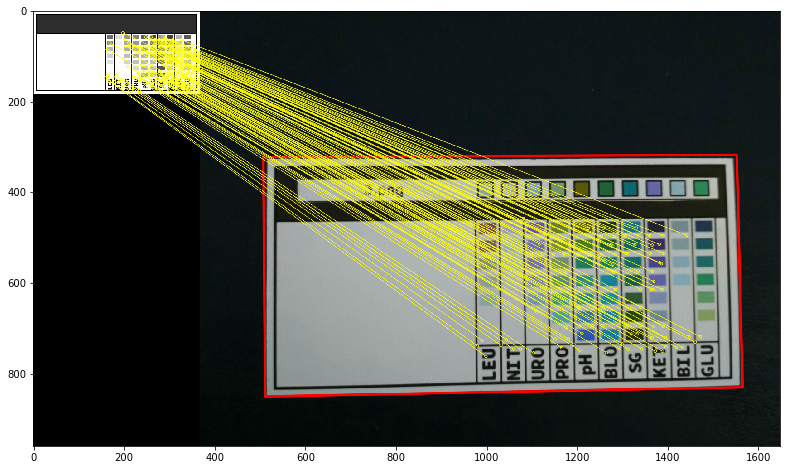

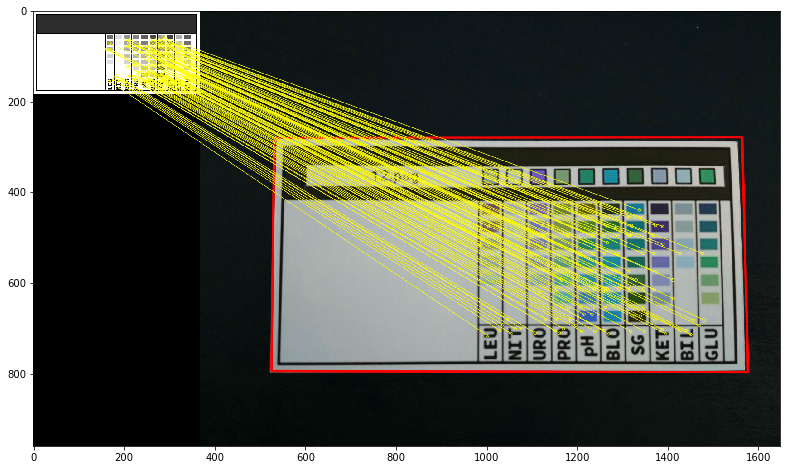

KeyboardInterrupt: 

In [166]:
image_names = glob.glob("../../images/stripe experiments/tests/good_printer/*/*.*")
for image_name in image_names:
    image = shrink(cv2.imread(image_name))
    match_image(image, query_image)